## AIMI High School Internship 2023
### Notebook 1: Extracting Labels from Radiology Reports

**The Problem**: Given a chest X-ray, our goal in this project is to predict the distance from an endotracheal tube to the carina. This is an important clinical task - endotracheal tubes that are positioned too far (>5cm) above the carina will not work effectively.

In order to train a model that can predict tube distances given chest X-rays, we require a ***training set*** with chest X-rays and labeled tube distances. However, when working with real-world medical data, important labels (e.g. endotracheal tube distances) are often not annotated ahead of time. The only data that a researcher has access to are the raw images and free-form clinical text written by the radiologist.

**Your First Task**: Given a set of chest X-rays and paired radiology reports, your goal is to use natural language processing tools to extract endotracheal tube distances from the reports.

**Looking Ahead**: When you complete this task, you should have a training dataset with chest X-rays labeled with endotracheal tube distances. You will later use this dataset to train a computer vision model that predicts the tube distance given an image.

### Load Data

Upload `data.zip`. It should take about 10 minutes for these files to be uploaded. Then, run the following cells to unzip the dataset (which should take < 10 seconds)

In [ ]:
!wget https://storage.googleapis.com/misc_jb/drive-download-20230620T044532Z-001.zip

--2023-06-30 04:59:28--  https://storage.googleapis.com/misc_jb/drive-download-20230620T044532Z-001.zip
Resolving storage.googleapis.com (storage.googleapis.com)... 64.233.188.128, 64.233.189.128, 108.177.97.128, ...
Connecting to storage.googleapis.com (storage.googleapis.com)|64.233.188.128|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 320879178 (306M) [application/zip]
Saving to: ‘drive-download-20230620T044532Z-001.zip’

drive-download-2023 100%[===================>] 306.01M  22.5MB/s    in 15s     

2023-06-30 04:59:43 (21.0 MB/s) - ‘drive-download-20230620T044532Z-001.zip’ saved [320879178/320879178]



In [ ]:
!unzip drive-download-20230620T044532Z-001.zip

Archive:  drive-download-20230620T044532Z-001.zip
  inflating: mimic_test_student.csv  
  inflating: mimic_train_student.csv  
  inflating: mimic-test.zip          
  inflating: mimic-train.zip         


In [ ]:
!unzip -qq /content/mimic-train.zip

In [ ]:
!unzip -qq /content/mimic-test.zip

### Understanding the Data

Let's first go through some terminology. Medical data is often stored in a hierarchy consisting of three levels: patient, study, and images.
- Patient: A patient is a single unique individual.
- Study: Each patient may have multiple sets of images taken, perhaps on different days. Each set of images is referred to as a *study*.
- Images: Each study consists of one or more *images*.

Chest X-ray images and radiology reports are stored in `data/` and are organized as follows:
- `data/mimic-train`:
  - Images: The MIMIC training set consists of 5313 subfolders, each representing a patient. Every patient has one or more studies, which are stored as subfolders. Images are stored in study folders as `.jpg` files with 512x512 pixels.
  - Text: Reports are stored in patient folders with  `.txt` extensions. The filename corresponds to the study id and the content of the report applies to all images in the corresponding study.
- `data/mimic-test`: The MIMIC test set is organized in a similar fashion as the MIMIC training set. Note that this is a held-out test set with 500 images that we will use for scoring models, so reports are not provided!
- `data/mimic_train_student.csv`: This spreadsheet provides mappings between image paths, report paths, patient ids, study ids, and image ids for samples in the training set.
- `data/mimic_test_student.csv`: This spreadsheet provides mappings between image paths, patient ids, study ids, and image ids for samples in the test set.

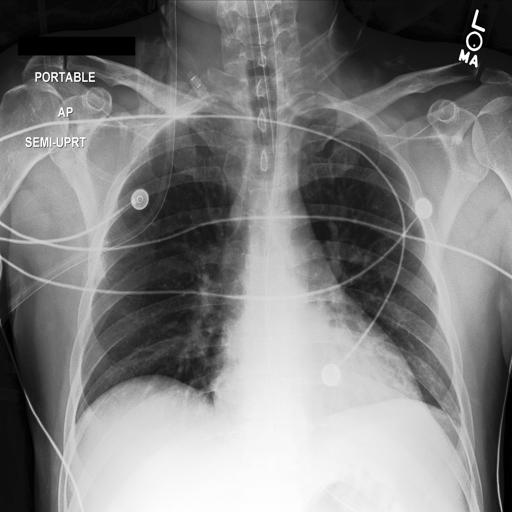

In [ ]:
# Example Image
from PIL import Image
img = Image.open(f"/content/mimic-train/12000/59707/90529.jpg")
img.show()

In [ ]:
# Example Text Report
with open(f"/content/mimic-train/12000/59707.txt", "r") as f:
  txt = f.readlines()
txt

['                                 FINAL REPORT\n',
 ' PORTABLE CHEST ___\n',
 ' \n',
 ' COMPARISON:  ___ radiograph.\n',
 ' \n',
 ' FINDINGS:  Tip of endotracheal tube terminates 6 cm above the carina. \n',
 ' Cardiomediastinal contours are normal in appearance, and lungs are grossly\n',
 ' clear.\n']

In [ ]:
# Load csv file with mappings
import pandas as pd
duh = pd.read_csv('/content/mimic_train_student.csv', usecols = ["image_path"])
image_paths = duh["image_path"]

### Extracting Tube Distance Labels

You're now ready to begin this task! Keep in mind that not every chest X-ray provided in the training set contains endotracheal tube distance information, and there may be several edge cases to consider.

In [ ]:
df = pd.read_csv('/content/mimic_train_student.csv', usecols = ["report_path", "patient_id", 'study_id'])
print(df)

       patient_id  study_id                  report_path
0           13282     56112  mimic-train/13282/56112.txt
1           13282     58693  mimic-train/13282/58693.txt
2           13360     54397  mimic-train/13360/54397.txt
3           13360     57560  mimic-train/13360/57560.txt
4           13360     62326  mimic-train/13360/62326.txt
...           ...       ...                          ...
12240       13795     60202  mimic-train/13795/60202.txt
12241       13795     60202  mimic-train/13795/60202.txt
12242       13818     59053  mimic-train/13818/59053.txt
12243       13906     62812  mimic-train/13906/62812.txt
12244       13906     59127  mimic-train/13906/59127.txt

[12245 rows x 3 columns]


In [ ]:
!pip install transformers

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.2/7.2 MB 46.6 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 236.8/236.8 kB 24.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.8/7.8 MB 64.5 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 58.3 MB/s eta 0:00:00


In [ ]:
from transformers import pipeline
from transformers import AutoTokenizer, AutoModelForTokenClassification

tokenizer = AutoTokenizer.from_pretrained("d4data/biomedical-ner-all")
model = AutoModelForTokenClassification.from_pretrained("d4data/biomedical-ner-all")

pipe = pipeline("ner", model=model, tokenizer=tokenizer, aggregation_strategy="simple")

In [ ]:
# report_paths = df["report_path"]
# patient_ids = df['patient_id']
# study_ids = df['study_id']
# distances = []
# for i in range(len(report_paths)):
#   with open(report_paths[i]) as f:
#     json = pipe(f.readlines())
#     # json = json[0]
#     print(json[1])
#     # if "Distance" in json.keys():
#     #   print(json)


#     # for j in json:
#     #   print(j)
#       # s = 'entity_group'
#       # #if (j[0] is not None):
#       # if (len(j) != 0) and (j[0]['entity_group'] == "Distance"):
#       #   distances.append([patient_ids[i], study_ids[i], j[0]['word']])



report_paths = df["report_path"]
patient_ids = df['patient_id']
study_ids = df['study_id']
distances = []

for i in range(len(report_paths)):
  with open(report_paths[i]) as f:
    #if i % 10 == 0:
      #print(i)
    json = pipe(f.readlines())
    print (json)
   # for j in json:
      #print (j)
      #if len(j) > 0 and "Distance" in j[0].values():
        #distances.append([patient_ids[i], study_ids[i], j[0]['word']])

#print(distances)


Streaming output truncated to the last 5000 lines.
[[{'entity_group': 'Diagnostic_procedure', 'score': 0.80372137, 'word': 'wet read', 'start': 1, 'end': 9}, {'entity_group': 'Time', 'score': 0.5241493, 'word': '_', 'start': 21, 'end': 22}, {'entity_group': 'Time', 'score': 0.9979549, 'word': '7 : 48 am', 'start': 23, 'end': 30}], [{'entity_group': 'Detailed_description', 'score': 0.91696095, 'word': 'end', 'start': 2, 'end': 5}, {'entity_group': 'Coreference', 'score': 0.8886786, 'word': 'tube', 'start': 15, 'end': 19}, {'entity_group': 'Distance', 'score': 0.99310386, 'word': '3 cm', 'start': 45, 'end': 49}], [], [], [{'entity_group': 'Diagnostic_procedure', 'score': 0.45967788, 'word': 'final report', 'start': 33, 'end': 45}], [{'entity_group': 'Diagnostic_procedure', 'score': 0.92905927, 'word': 'examination', 'start': 1, 'end': 12}, {'entity_group': 'Biological_structure', 'score': 0.99990034, 'word': 'chest', 'start': 15, 'end': 20}], [], [{'entity_group': 'Detailed_description',

In [ ]:
import re
def make_true (distance):
  # print(distance)

  # converts the metrics names to mm or cm
  distance = distance.strip()
  # returns -1 if there are additional words in the distance
  values = re.split(r'\W+', distance)
  count = 0
  c_count = 0
  # print(values)
  for v in values:
    if v.isalpha():
      count = count + 1
  # print(len(values))
  if count>1 or len(values) == 1:
    return -1

  distance = re.sub(r'[cent]\w+', "cm", distance)
  distance = re.sub(r'[mil]\w+', "mm", distance)
  # gets the metric
  metric = distance[-2:]
  number = distance[:-2]

  # removes any leading and trailing characters
  number = number.replace(" ", "")
  number = re.sub("[^0-9]", ".", number)
  number = re.findall(r'[-+]?(?:\d*\.*\d+)', number)
  if number == []:
    return -1
  number = float(number[0])

  # converts values that are mm to cm
  if metric == "mm":
    return number * 0.1
  return number

In [ ]:
def measurement (options):
  for i in options:
    if any(chr.isdigit() for chr in i):
      if ('c' in i) or ('m' in i):
        return i
  return -1


In [ ]:
from google.colab import files
uploaded = files.upload()


In [ ]:
import csv
fi = open ("dist.csv", 'w', newline = '')
writer = csv.writer(fi)
for i in distances:
  row = i[0], i[1], i[2]
  writer.writerow(row)
fi.close()

In [ ]:
import numpy as np
header = ['patient id', 'study id', 'distance', 'image path']
dist = open ("distances.csv", 'w', newline = '')
writer = csv.writer(dist)
writer.writerow(header)
counter = 0
studys = pd.DataFrame(study_ids).to_numpy()
for i in distances:
  num = i[1]
  row = i[0], i[1], make_true(i[2]), image_paths[np.where(studys == num)[0][0]]
  writer.writerow(row)
  counter+=1
dist.close()

In [ ]:
new = pd.read_csv('distances.csv')
print (new)
new.drop_duplicates(subset = ['study id'])
print (new)
new.to_csv('real_data.csv', sep='\t')

In [ ]:
import requests
import time

while True:
    try:
        requests.get('https://www.google.com')
        print("Kept alive.")
    except:
        print("Failed to keep alive.")
    time.sleep(600)